In [26]:
import numpy as np
%tensorflow_version 2.x

import matplotlib.pyplot as plt
import scipy.ndimage
import skimage.transform
import random
import tensorflow as tf
import cv2
import os
import glob
 

# Feature Visualization

Here you can load a pretrained model form tf.keras.applications.
You can also load your own model.


In [27]:
#@title Choose which network to use { form-width: "500px" }
model_name = "MobileNetV2" #@param ["MobileNetV2", "InceptionV3", "DenseNet121", "ResNet101"]
model_func = "tf.keras.applications." + model_name + "(include_top=True, weights='imagenet')"
model = eval(model_func)
 

- Inception V3 
    - shape 299, 299,3
    - -1 to 1
- Mobile Net
    - shape 224, 224, 3
    - -1 to 1

In [28]:
model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
_______________________________________________________________________________

## Feature Visualization

### Some Support Functions

In [29]:
def l1_regularization(img,l = 0.005):
   return tf.convert_to_tensor(l * tf.math.reduce_sum(tf.math.abs(img)), dtype=tf.float32) 

def sigmoid(x):
   return 1/(1+np.exp(-x))

def jitter(img, jitter):
    jitter = random.choice(jitter)
    img = tf.pad(img, tf.constant([[jitter, jitter], [jitter, jitter], [0, 0]]), "SYMMETRIC")
 
    img = tf.convert_to_tensor(img)
    img_shp = tf.shape(img)
    offset_width, offset_height = random.choice([(0,0), (2*jitter, 0),
                                                 (0, 2*jitter), (2*jitter, 2*jitter)])
    crop = tf.image.crop_to_bounding_box(
        img, offset_height, offset_width, img_shp[1]-2*jitter, img_shp[1]-2*jitter)
     
    
    return crop 

# seems to be buggy
def jitter2(img, jitter):
    jitter_ratio = img.shape[1]/jitter
    img = tf.keras.preprocessing.image.random_shift(
        np.array(np.array(img), jitter_ratio, jitter_ratio, row_axis=0, col_axis=1, channel_axis=2, fill_mode='nearest'))
    return img

def random_scale(img, factors):
    img = tf.expand_dims(tf.convert_to_tensor(img),0)
    factor = random.choice(factors)
    shp = tf.shape(img)
    scale_shape = tf.cast(factor * tf.cast(shp[-3:-1], "float32"), "int32")
    return tf.squeeze(tf.image.resize(img, scale_shape))
 
def random_rotate(img, degrees):
    angle = random.choice(degrees)
    angle = (360 + angle) % 360
    return scipy.ndimage.rotate(img, angle=angle, reshape=False, mode='reflect')
 
def plot_img(img):
    plt.figure(figsize=(5,5))
    plt.axis('off')
    img_show = tf.cast(255*(tf.squeeze(img) + 1.0)/2.0, tf.uint8)
    plt.imshow(img_show)
    plt.show()
 

In [30]:

def normalize_image(img):
    img = np.asarray(img,dtype=np.float32)
    return 2*(img - img.min()) / (img.max() - img.min()) - 1

def pixel_image(shape,sd=1, pixel_format='centered', init_val=None):
    if init_val != None:
        rnd_img = np.full(shape, init_val)
    else:
        rnd_img = np.random.normal(scale=1,size=shape)
    rnd_img = rnd_img.astype(np.float32)
    rnd_img = tf.nn.sigmoid(rnd_img)
    if pixel_format=='centered':
        rnd_img = (rnd_img-0.5)*2.0
    rnd_img = tf.convert_to_tensor(rnd_img,dtype=np.float32)
    return tf.Variable(rnd_img, trainable=True)


def transformation_robustness(img):
    img = tf.squeeze(img)
    x,y,_ = img.shape
    

    img = jitter(img,list(range(1, 4)) + 3 * [0])
    
    # scale with a random factor
    # resize seems to have color side effects
    #img = random_scale(img, [1.025, 1.01, 0.975, 0.99, 1, 1, 1, 1]) 
 
    # rotate with random angle
    img = random_rotate(img,list(range(-2, 3)) + 5 * [0])
    # jitter up to 4 pixels
 
    img = jitter(img,list(range(1, 2)) + 2 * [0])
 
     
    # only needed for scaling
    #img = tf.image.resize_with_crop_or_pad(img, x, y)
 
    return img

In [31]:
from matplotlib import animation, rc
from IPython.display import HTML
def animate_images(images, fps=30):   
    plt_images = []

    fig = plt.figure(figsize=(17,7))
    plt.gca().set_axis_off()

    for image in images:
        plt_image = plt.imshow(tf.cast(255*(image + 1.0)/2.0, tf.uint8), animated=True)
        plt_images.append([plt_image])
    ani = animation.ArtistAnimation(fig, plt_images, interval=1000/fps, blit=True, repeat=True, repeat_delay=2000)
    plt.close()
    rc('animation', html='jshtml')
    return HTML(ani.to_html5_video())

### Algorithm for Image Optimization
A random input image is optimized towards activating a chosen feature map. Different regularizations techniques to improve image quality can be selected.


In [55]:
def optimize_image(model, shape, lr=0.05, steps=512, total_variation=None, l1=None, blur=None, blur_step=1, blur_gradient=False,
                   init_val=None, transformation=True, transformation_steps=1, use_optimizer=True, normalize_gradients=True, plot=False, plot_step = 100, record_images=True):
    """ Optimizes a random image to maximally activate the chosen unit of the chosen featuremap using gradient ascent
    Parameters
    ----------img1 = optimize_image(visualization_model, shape=(1,224,224,3), lr=0.05, steps=1024, transformation=False, use_optimizer=False, transformation_steps=1, plot=True)
    model: tf.keras.Model
        Visualization Model which outputs featuremap
    shape: tuple
       shape of input (batch, height, width, channels)
    lr: float
        learning rate
    steps: int
        number of optimization steps
    total_variation: float
        scaling for total variation penatly
    l1: float
        scaling for l1 penalty
    blur: boolean
        one of 'gaussian' or 'bilateral'
    blur_step: int
        image gets blurred every blur_step steps
    blur_gradient:
        if true uses gaussian to blur gradient
    init_val: int
        initial pixel value for image
        if None img is randomly initialized
    transformation: boolean
        if true applies transformation robustness 
    transforformation_steps: int
        apply transformations every transformation_steps step
    use_optimizer: boolean
        if True uses Adam, if False standard gradient descent
    normalize_gradients: boolean
        if true gradients are divided by their stdv
    plot: boolean
        if True plot intermediate images
    plot steps:
        step size for intermediate results
    record_images:
        if true returns all images
        if false return empty list
 
    returns
    -------
    img: tf.tensor
        optimized image
    imgs: list
        images of all steps

    """

    tf.keras.backend.clear_session()
   
    if use_optimizer:
        optimizer = tf.optimizers.Adam(lr)

    # initialize img
    img = pixel_image(shape, init_val=init_val)
     
    average_activations = []
    steps_ar = []
    imgs = []


    # training loop
    # like you know it but with a bunch of ifs for different regularizers
    for step in range(steps):

        if transformation and step%transformation_steps == 0:
            img_rbst = tf.expand_dims(transformation_robustness(img), 0)
            # assign new value to a tf.Variable. Important for Adam to work
            img.assign(img_rbst)


        with tf.GradientTape() as tape:
            tape.watch(img)
            out_fm = model(img)     
            average_activation = tf.reduce_mean(out_fm)

            # l1 or total variation as penalty
            if total_variation != None:
                regularization_penalty = tf.image.total_variation(img) * total_variation
            elif l1 != None:
                regularization_penalty = l1_regularization(img, l=l1) 
            else:
                regularization_penalty = 0
 
            regularized_activity = average_activation - regularization_penalty 
            
            # Compute the gradients to maximize the average activation in respect to the image.
            if use_optimizer:
                gradients = tape.gradient(-regularized_activity, img)
            else:
                gradients = tape.gradient(regularized_activity, img)
     
        if blur_gradient:
            gradients = cv2.GaussianBlur(np.asarray(tf.squeeze(gradients)),(7,7), 1)
            gradients = tf.expand_dims(tf.convert_to_tensor(gradients),0)
             
        # Normalize gradients.
        if normalize_gradients:
            gradients /= tf.math.reduce_std(gradients) + 1e-8
        
         

         
        # Apply gradients to the image.
        if use_optimizer:
            optimizer.apply_gradients([(gradients, img)])
        else:
            img.assign(img + lr*gradients)
         




        if blur == 'bilateral' and step%blur_step == 0: 
            filtered = cv2.bilateralFilter(np.asarray(tf.squeeze(img)), 7,0.6,0.7)
            img.assign(tf.expand_dims(tf.convert_to_tensor(filtered),0))
        if blur == 'gaussian' and step%blur_step == 0: 
            # sigma decreases with steps
            sigma = 1.5 - sigmoid((step/steps - 0.5) * 8)
            filtered = cv2.GaussianBlur(np.asarray(tf.squeeze(img)),(7,7), sigma)
            img.assign(tf.expand_dims(tf.convert_to_tensor(filtered),0))




        ######################
        
        # Make sure values stay between -1 and 1.
        img.assign(tf.clip_by_value(img, -1, 1))
        


        # store activations for plotting
        steps_ar.append(step)
        average_activations.append(average_activation)
        if record_images:
            imgs.append(tf.squeeze(img))

        if step%plot_step == 0 and plot:
            plt.figure(figsize=(5,5))
            plt.axis('off')
            img_show = tf.cast(255*(tf.squeeze(img) + 1.0)/2.0, tf.uint8)
            plt.imshow(img_show)
            plt.title("step: " + str(step) + "  average activation: "+ str(average_activations[-1].numpy()))
            plt.show()
         
    
    if plot:
        plt.figure(figsize=(14,7))
        plt.title("average activation over optimization steps")
        plt.xlabel("steps")
        plt.ylabel("average activation")
        plt.plot(steps_ar, np.asarray(average_activations))

        fig = plt.figure(figsize=(5,5))
        plt.axis('off')
        img_show = tf.cast(255*(tf.squeeze(img) + 1.0)/2.0, tf.uint8)
        plt.imshow(img_show)
        plt.title("step: " + str(steps) + "  average activation: "+ str(average_activations[-1].numpy()))
        plt.show()

    
    return tf.squeeze(img), imgs
            

### Naive Feature Visualization


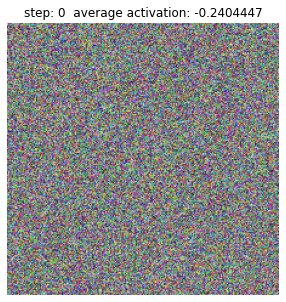

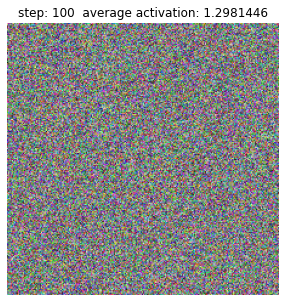

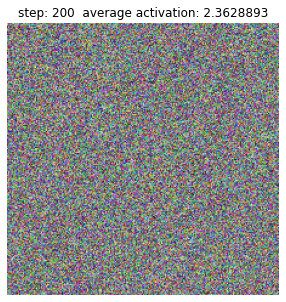

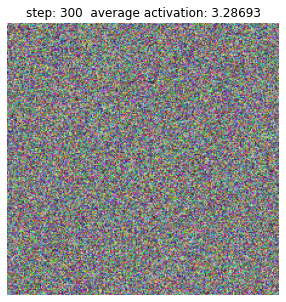

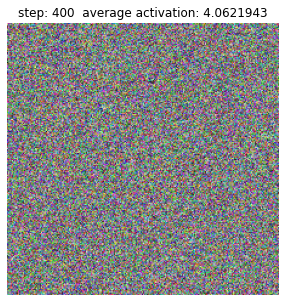

...

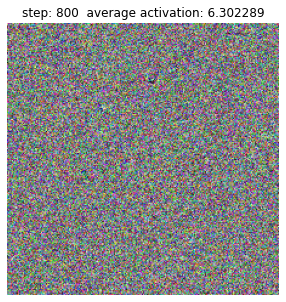

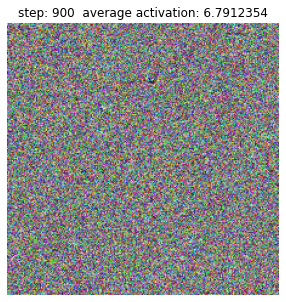

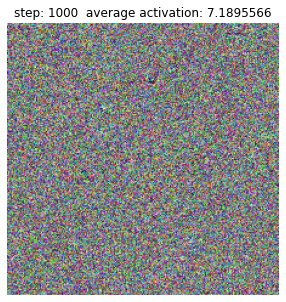

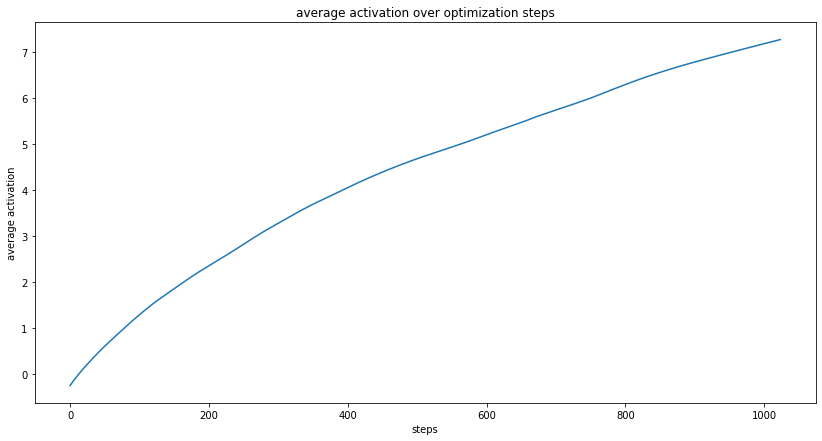

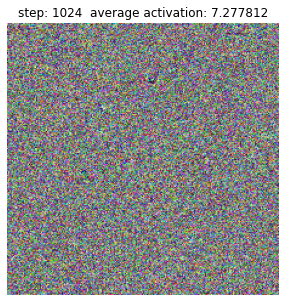

In [33]:
imgs = []
# adjust layer name according to the model you are using
# call model.summary() to get the layer names
# the layer to visualize
layer = 'block_12_add'

# the featuremap to visualize
unit = 1

# the shape of the img
shape = (1, 224, 224, 3)

# re load the model
model = eval(model_func)

# 
feature_map = model.get_layer(layer).output[:,:,:,unit] 

visualization_model = tf.keras.Model(
                            inputs=model.inputs, 
                            outputs=feature_map
                        )
img_naive, _ = optimize_image(visualization_model, shape=shape, lr=0.05, steps=1024, transformation=False, use_optimizer=False, normalize_gradients=False, plot=True)
imgs.append(('naive', img_naive))

### Normalize Gradients
 

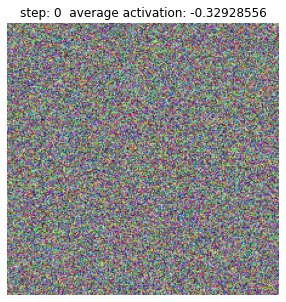

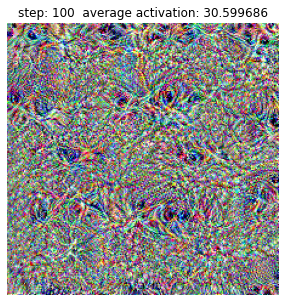

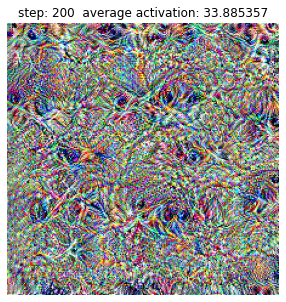

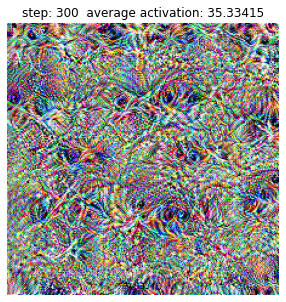

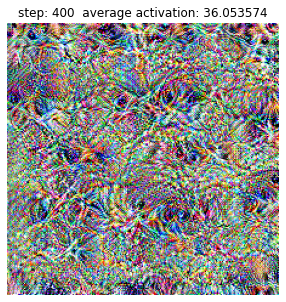

...

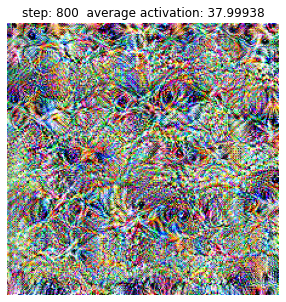

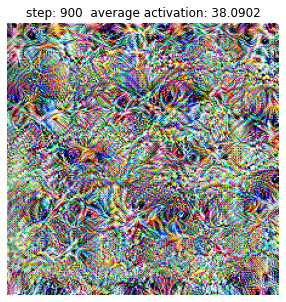

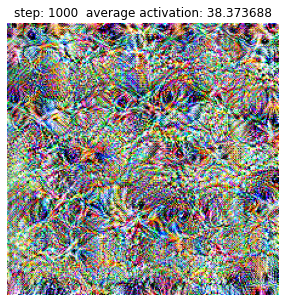

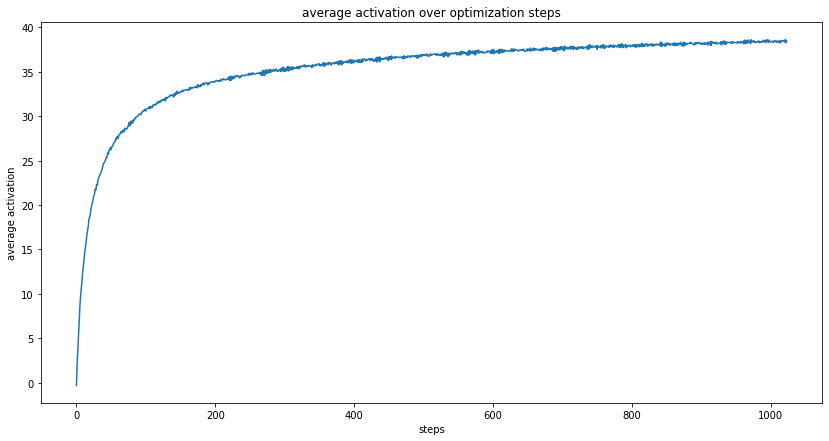

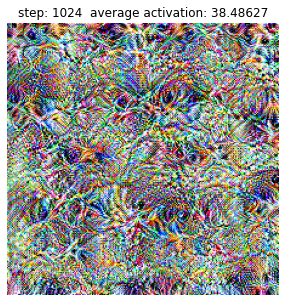

In [34]:
img_norm, _ = optimize_image(visualization_model, shape=shape, lr=0.05, steps=1024, transformation=False, use_optimizer=False, plot=True)
imgs.append(('normalized gradient', img_norm))

### Adam Optimizer


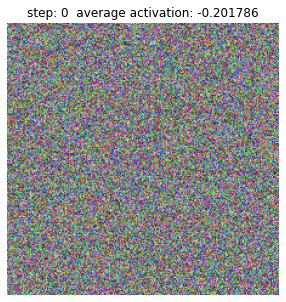

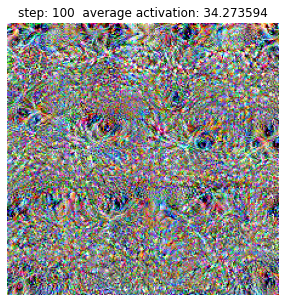

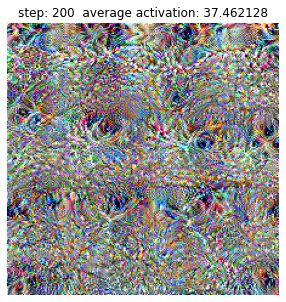

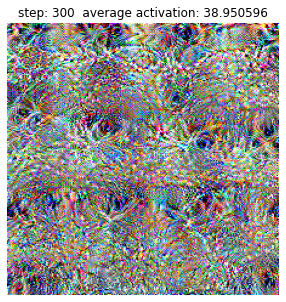

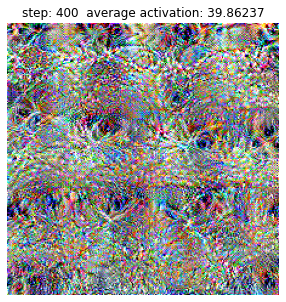

...

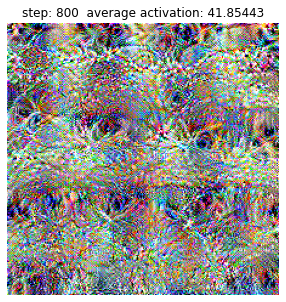

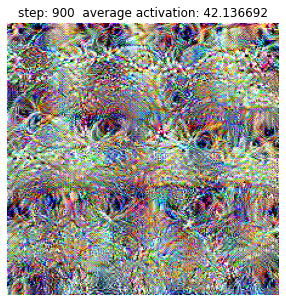

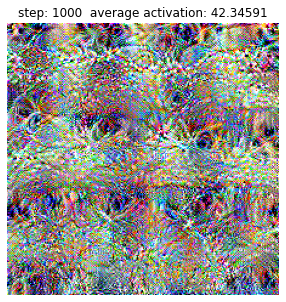

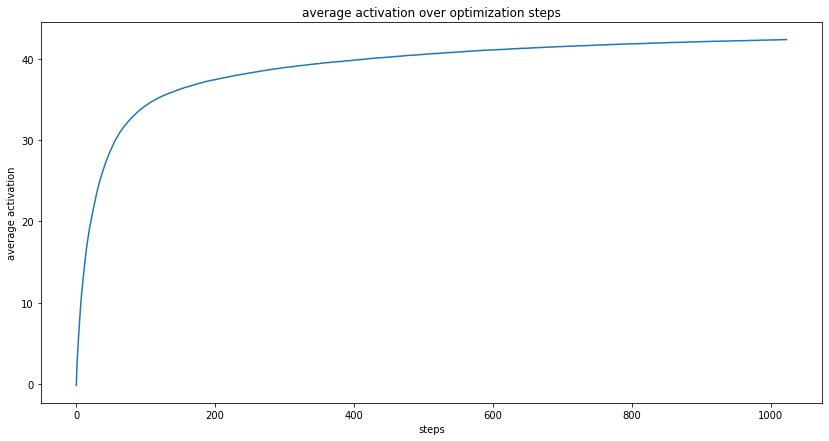

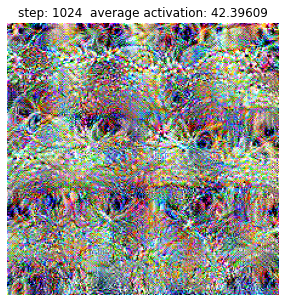

In [35]:
img_adam, _ = optimize_image(visualization_model, shape=shape, lr=0.05, steps=1024, transformation=False, use_optimizer=True, plot=True)
imgs.append(('Adam', img_adam))

### Loss Penalties
Lets try to surpress noise by including a penalties in the loss function which punish images with high frequency patterns.
- L1 Regulariation: Penalizes overall high pixel values. 
- Total Variation: Penalizes differences between neighboring pixels

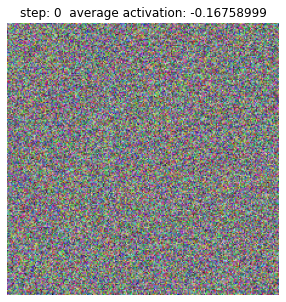

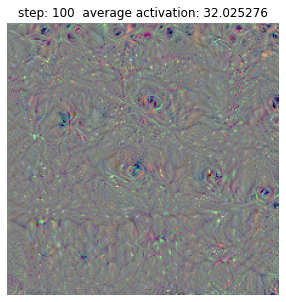

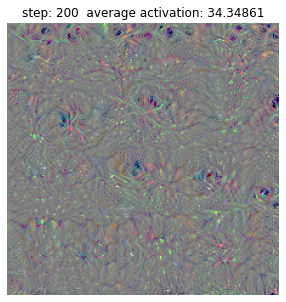

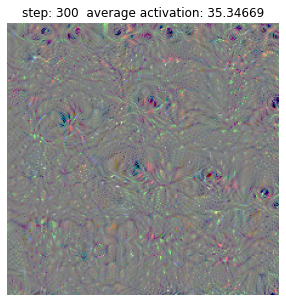

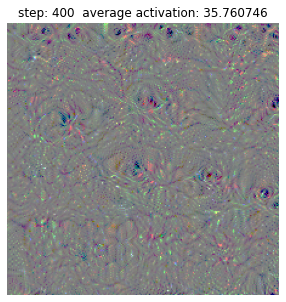

...

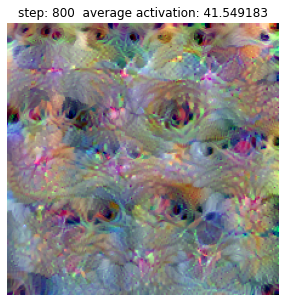

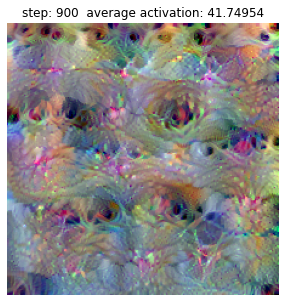

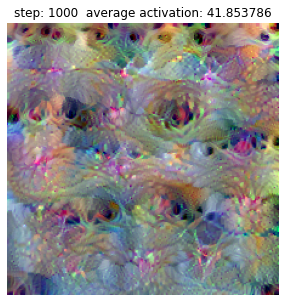

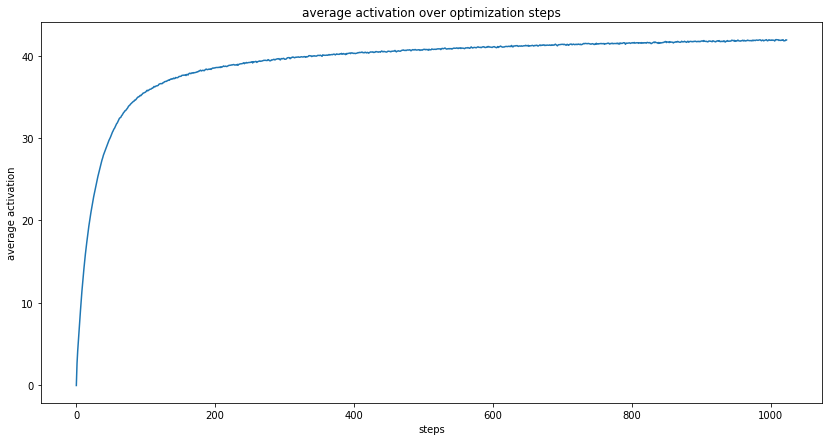

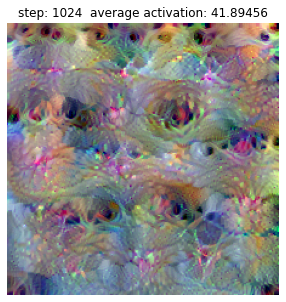

In [36]:
img_l1, _ = optimize_image(visualization_model, shape=(1,224,224,3), lr=0.05, steps=1024, transformation=False, l1=0.001, transformation_steps=1, plot=True)
img_tv, imgs_tv  = optimize_image(visualization_model, shape=(1,224,224,3), lr=0.05, steps=1024, transformation=False, total_variation=0.0003, transformation_steps=1, plot=True, record_images=True)
imgs.append(('L1', img_l1))
imgs.append(('Total Variation', img_tv))

### Blurring Images
- Gaussian Filter
- Bilateral Filter

You can also blur the gradients but blurring the images them selves yields better results.

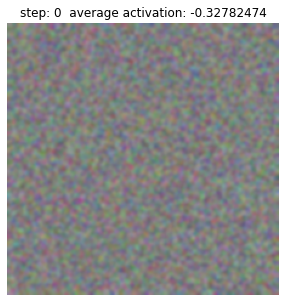

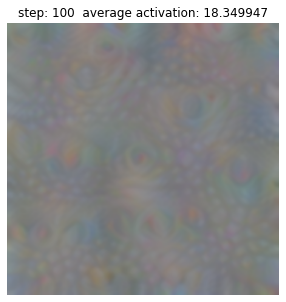

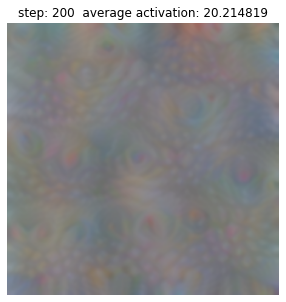

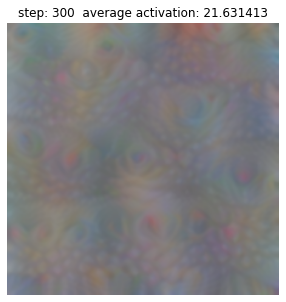

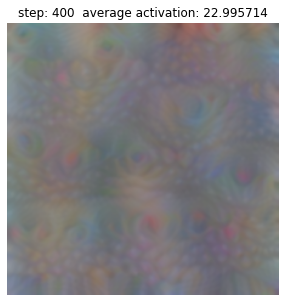

...

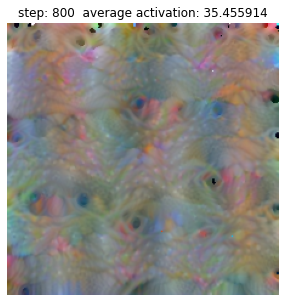

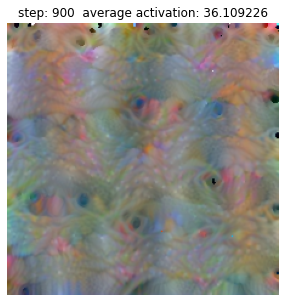

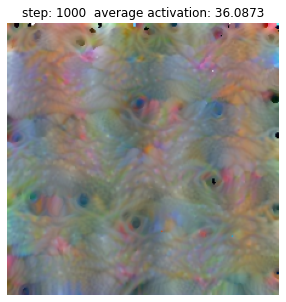

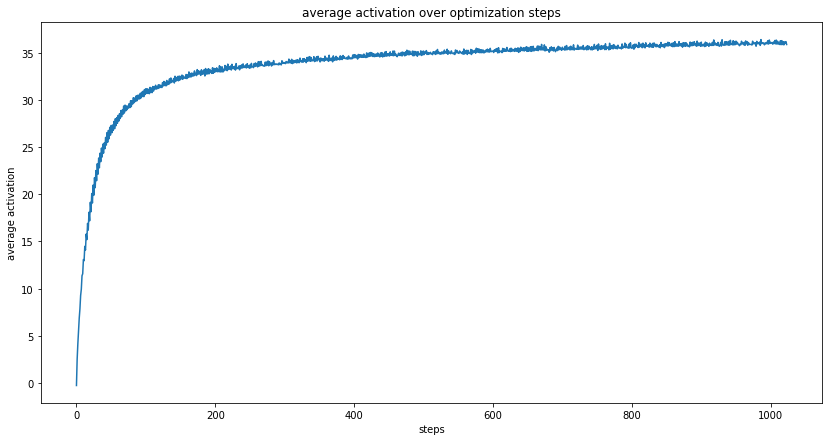

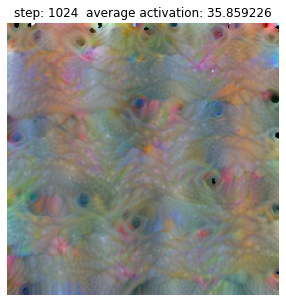

In [37]:
img_gaussian, _ = optimize_image(visualization_model, shape=shape, steps=1024, transformation = False, lr=0.05, blur='gaussian', blur_step=1, plot=True)
img_bilateral, imgs_bilateral = optimize_image(visualization_model, shape=shape, steps=1024, transformation = False, use_optimizer=False, lr=0.05, blur='bilateral', blur_step=2, plot=True, record_images=True)
img_bilateral_adam, _ = optimize_image(visualization_model, shape=shape, steps=1024, transformation = False, lr=0.05, blur='bilateral', blur_step=2, plot=True)
imgs.append(('Gaussian Blur', img_gaussian))
imgs.append(('Bilateral Blur, No Adam', img_bilateral))
imgs.append(('Bilateral Blur', img_bilateral_adam))

### Transformation Robustness
Apply small transfomrations to the input image to make the optimization process more robust.
For example:
- jitter
- rotation
- (scaling)

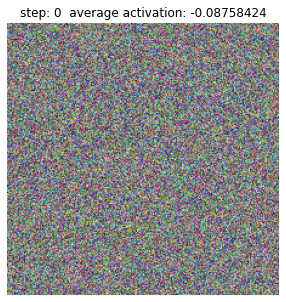

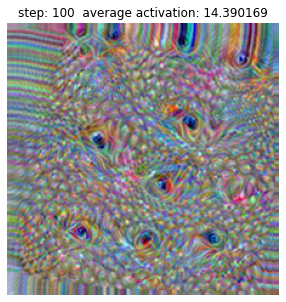

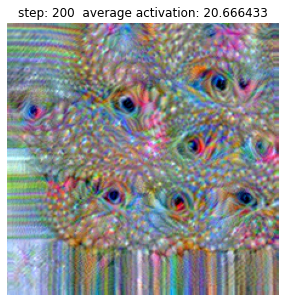

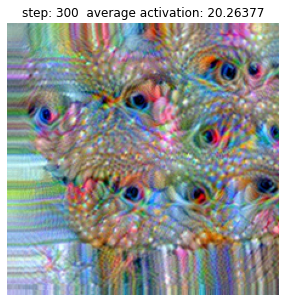

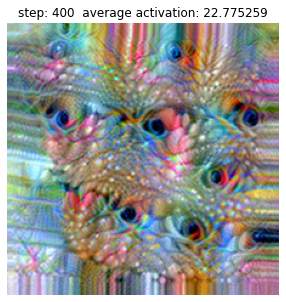

...

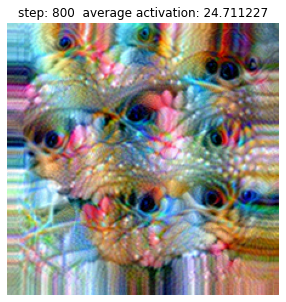

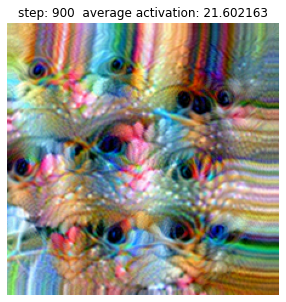

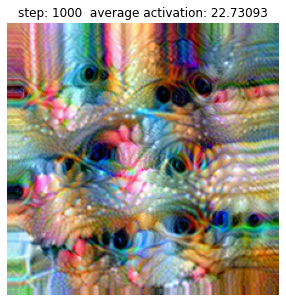

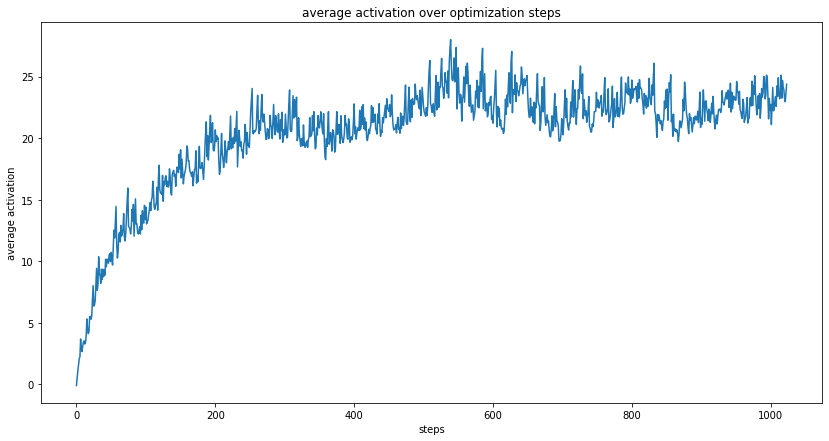

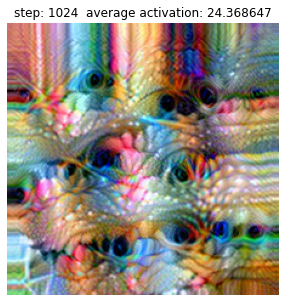

In [38]:
img_tr, imgs_tr = optimize_image(visualization_model, shape=shape, steps=1024, transformation=True, plot=True, record_images=True)
imgs.append(('Transformation Robustness', img_tr))

## Compare Approaches

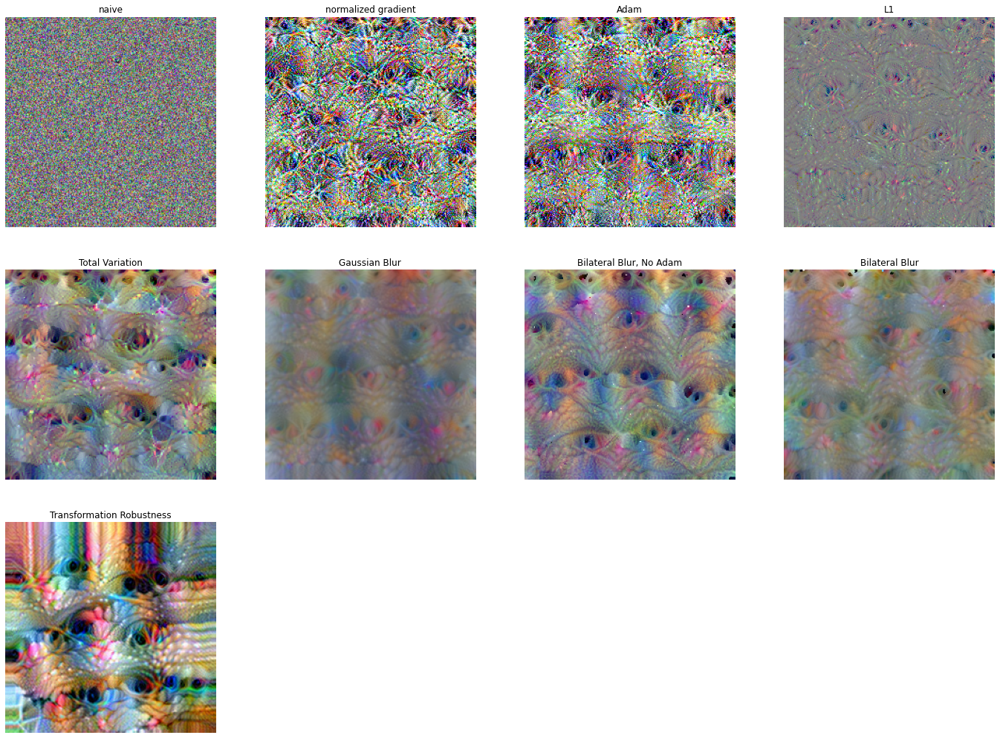

In [39]:
gridsize = int(np.sqrt(len(imgs))) + 1
fig = plt.figure(figsize=(gridsize*6,gridsize*6))
for i, (label, img) in enumerate(imgs):
    plt.subplot(gridsize, gridsize,i+1)
    plt.axis('off')
    plt.title(label)
    img_show = tf.cast(255*(img + 1.0)/2.0, tf.uint8)
    plt.imshow(img_show)
plt.show()

### Watch the training progress as a video
For this set record_imgaes=True and give the resulting list to the animate_images function

In [40]:
animate_images(imgs_tr, fps=60)

In [41]:
animate_images(imgs_bilateral, fps=60)

In [42]:
animate_images(imgs_tv, fps=60)

## Visualizing Classes
Classes are the hardest to visualize as the gradeints have to backpropagate through the most layers. The visualiaztions tend to be pretty noisy. You might have better luck for smaller networks.

Lets get the imagenet classnames

In [43]:
# print classes
preds = np.zeros((1000,1000))

for i in range(1000):
    preds[i,i] = 1
class_names = tf.keras.applications.mobilenet_v2.decode_predictions(preds, top=1)
 
class_dict = {i : name[0][1] for i, name in enumerate(class_names)}
for i in class_dict:
    print(i, ": ", class_dict[i])

0 :  tench
1 :  goldfish
2 :  great_white_shark
3 :  tiger_shark
4 :  hammerhead
5 :  electric_ray
6 :  stingray
7 :  cock
8 :  hen
9 :  ostrich
10 :  brambling
11 :  goldfinch
12 :  house_finch
13 :  junco
14 :  indigo_bunting
15 :  robin
16 :  bulbul
17 :  jay
18 :  magpie
19 :  chickadee
20 :  water_ouzel
21 :  kite
22 :  bald_eagle
23 :  vulture
24 :  great_grey_owl
25 :  European_fire_salamander
26 :  common_newt
27 :  eft
28 :  spotted_salamander
29 :  axolotl
30 :  bullfrog
31 :  tree_frog
32 :  tailed_frog
33 :  loggerhead
34 :  leatherback_turtle
35 :  mud_turtle
36 :  terrapin
37 :  box_turtle
38 :  banded_gecko
39 :  common_iguana
40 :  American_chameleon
41 :  whiptail
42 :  agama
43 :  frilled_lizard
44 :  alligator_lizard
45 :  Gila_monster
46 :  green_lizard
47 :  African_chameleon
48 :  Komodo_dragon
49 :  African_crocodile
50 :  American_alligator
51 :  triceratops
52 :  thunder_snake
53 :  ringneck_snake
54 :  hognose_snake
55 :  green_snake
56 :  king_snake
57 :  gar

Load the network without the classifier to gain access to the pre_softmax logits.
Visualizing after Softmax produces bad results, as gradeint descent can maximize the probability for one class by minimzing the probability for other classes. The visualizations therefore do not have to show anything class related.
Not a problem for the pre softmax class activations.

In [56]:
layer = 'predictions'

# choose unit of 0 to 999
unit = 999
# load without classifier activation to access class logits
model_classes = tf.keras.applications.MobileNetV2(include_top=True, weights='imagenet', classifier_activation=None)

feature_map_classes = model_classes.get_layer(layer).output[:,unit] 


visualization_model_classes = tf.keras.Model(
                            inputs=model_classes.inputs, 
                            outputs=feature_map_classes
                        )

Lets try the last class: toilet paper

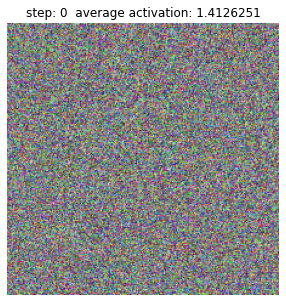

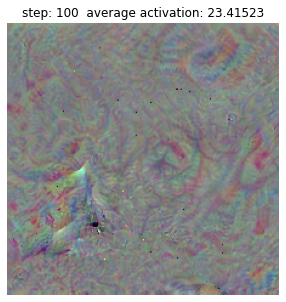

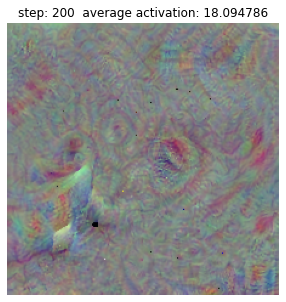

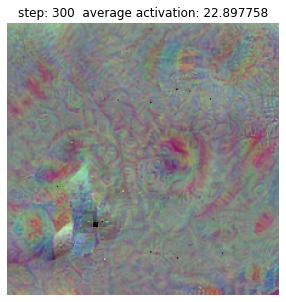

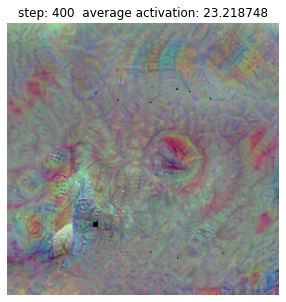

...

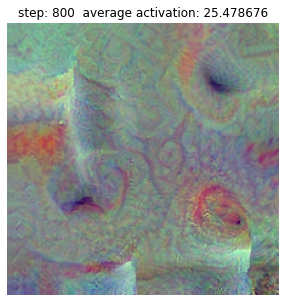

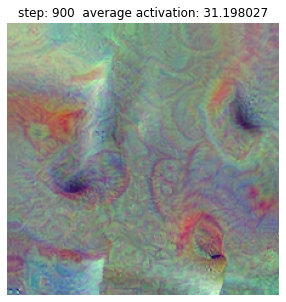

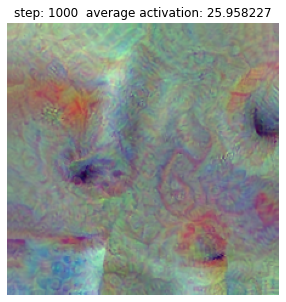

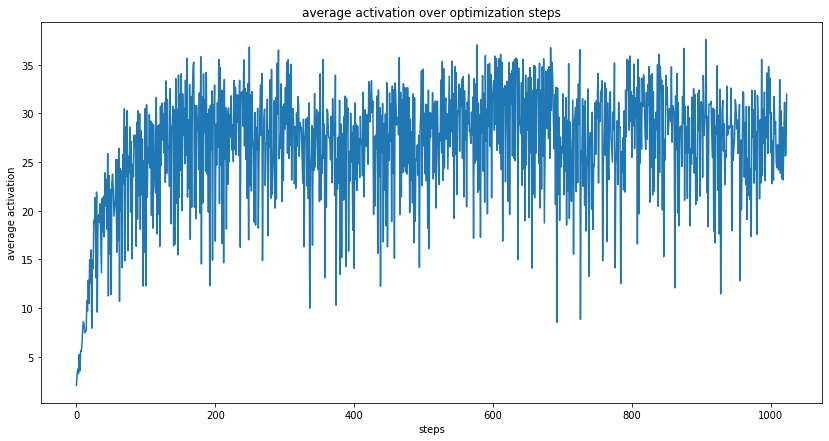

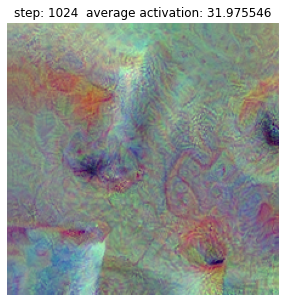

In [59]:
img_tp, imgs_tp = optimize_image(visualization_model_classes, shape=(1,224,224,3), lr=0.05, steps=1024, total_variation=0.0003, transformation=False, use_optimizer=False, blur='bilateral', blur_step = 2, plot=True, record_images=True)
img_tp_2, imgs_tp_2 = optimize_image(visualization_model_classes, shape=(1,224,224,3), lr=0.05, steps=1024, transformation=True, blur='bilateral', blur_step=2, use_optimizer=False, plot=True, record_images=True)


## Try your Own Model
You can for example use the CIFAR 10 model you trained on for the homework.
Although the resolution will be worse, networks with fewer layers produce less noisy visualizations.

## Other Stuff to Try

- negative channel visualizations (what activates a featuermap the least)
- try which combination of regularizations works best
- do a better job of edge handling for transformation robustness than me
